In [21]:
import pickle
import torch
from sklearn import datasets
from sklearn.utils import resample
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from statistics import mean
from math import ceil
from collections import OrderedDict
import data_generator

device cpu


In [2]:
from moe_models import moe_stochastic_model, moe_stochastic_loss,  cross_entropy_loss
from moe_models import moe_expectation_model, moe_pre_softmax_expectation_model
from experts_gates import expert_layers, expert_layers_presoftmax, gate_layers

In [29]:
model_file = '/Users/peac004/modular_learning_research/modular_deep_learning/results/expert_1_gate_1_single_shallow_multi_class_3000_results.pt'

In [30]:
result = torch.load(open(model_file,'rb'), 
                    map_location=torch.device('cpu'))

device cpu


In [5]:
dataset = 'multi_class'
X, y, trainset, trainloader, testset, testloader, num_classes = data_generator.generate_data(dataset, 3000, 128, 4)

2400
3600
600
900


In [6]:
#create meshgrid
generated_data = data_generator.create_meshgrid(X)

In [7]:
def labels(p, palette=['r','c','y','g']):
    pred_labels = torch.argmax(p, dim=1)+1
    uniq_y = np.unique(pred_labels)
    pred_color = [palette[i-1] for i in uniq_y]
    return pred_color, pred_labels

In [8]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
def predict(dataloader, model):
        
        pred_labels = []
        true_labels = []
        for i, data in enumerate(dataloader):
            inputs, labels = data
            true_labels.append(labels)
            pred_labels.append(torch.argmax(model(inputs), dim=1))
            
        return torch.stack(true_labels), torch.stack(pred_labels)

In [9]:
colors = ['y', 'tab:purple', 'tab:green', 'tab:orange']

In [ ]:
for i in range(1,6):
    fig,ax = plt.subplots(1, 4, sharex=True, sharey=True, figsize=(25,5))
    ax = ax.flatten()
    single_model = result['single_model']['experts'][i]['model']
    parameters = result['single_model']['experts'][i]['parameters']

    pred = single_model(generated_data)
    pred_color,pred_labels = labels(pred)
    sns.scatterplot(x=generated_data[:,0],y=generated_data[:,1],
                    hue=pred_labels,palette=pred_color, legend=False, ax=ax[0])
    sns.scatterplot(x=X[:,0], y=X[:,1], hue=y, palette=colors[0:num_classes], ax=ax[0])
    ax[0].set_title('Single Model - '+str(i)+' Experts with '+str(parameters)+' Params')
    ax[0].set_ylabel('Dim 2')
    ax[0].set_xlabel('Dim 1')
    
    moe_model = result['moe_expectation_model']['experts'][i]['model']
    parameters = result['moe_expectation_model']['experts'][i]['parameters']

    pred = moe_model(generated_data)
    pred_color,pred_labels = labels(pred)
    sns.scatterplot(x=generated_data[:,0],y=generated_data[:,1],
                    hue=pred_labels,palette=pred_color, legend=False, ax=ax[1])
    sns.scatterplot(x=X[:,0], y=X[:,1], hue=y, palette=colors[0:num_classes], ax=ax[1])
    ax[1].set_title('MOE Expectation Model - '+str(i)+' Experts with '+str(parameters)+' Params')
    ax[1].set_ylabel('Dim 2')
    ax[1].set_xlabel('Dim 1')
    
    moe_model = result['moe_stochastic_model']['experts'][i]['model']
    parameters = result['moe_stochastic_model']['experts'][i]['parameters']

    pred = moe_model(generated_data)
    pred_color,pred_labels = labels(pred)
    sns.scatterplot(x=generated_data[:,0],y=generated_data[:,1],
                    hue=pred_labels,palette=pred_color, legend=False, ax=ax[2])
    sns.scatterplot(x=X[:,0], y=X[:,1], hue=y, palette=colors[0:num_classes], ax=ax[2])
    ax[2].set_title('MOE Stochastic Model - '+str(i)+' Experts with '+str(parameters)+' Params')
    ax[2].set_ylabel('Dim 2')
    ax[2].set_xlabel('Dim 1')
    
    moe_model = result['moe_pre_softmax_expectation_model']['experts'][i]['model']
    parameters = result['moe_pre_softmax_expectation_model']['experts'][i]['parameters']

    pred = moe_model(generated_data)
    pred_color,pred_labels = labels(pred)
    sns.scatterplot(x=generated_data[:,0],y=generated_data[:,1],
                    hue=pred_labels,palette=pred_color, legend=False, ax=ax[3])
    sns.scatterplot(x=X[:,0], y=X[:,1], hue=y, palette=colors[0:num_classes], ax=ax[3])
    ax[3].set_title('MOE Pre Softmax Expectation Model - '+str(i)+' Experts with '+str(parameters)+' Params')
    ax[3].set_ylabel('Dim 2')
    ax[3].set_xlabel('Dim 1')
    

In [78]:
datasets = ['fashion_mnist_all_loss_importance_0.5_10000',
            'fashion_mnist_all_loss_importance_1.0_10000',
            'fashion_mnist_all_loss_importance_1.5_10000']

In [9]:
import torch
import torchvision as tv
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

In [6]:
#transform = tv.transforms.Compose()
trainset = tv.datasets.FashionMNIST('data', transform=tv.transforms.ToTensor(), train=True)
trainset

Dataset FashionMNIST
    Number of datapoints: 60000
    Root location: data
    Split: Train
    StandardTransform
Transform: ToTensor()

In [7]:
testset = tv.datasets.FashionMNIST('data',transform=tv.transforms.ToTensor(), train=False)
testset

Dataset FashionMNIST
    Number of datapoints: 10000
    Root location: data
    Split: Test
    StandardTransform
Transform: ToTensor()

In [10]:
train_size = 10000
trainloader = torch.utils.data.DataLoader(torch.utils.data.Subset(trainset,list(range(0,train_size))), 
                                          batch_size=train_size,
                                          shuffle=False, num_workers=1)
test_size = 3000
testloader = torch.utils.data.DataLoader(torch.utils.data.Subset(testset,list(range(0,test_size))),
                                         batch_size=test_size,
                                         shuffle=False, num_workers=1)


In [11]:
from sklearn.decomposition import IncrementalPCA
from sklearn.manifold import TSNE

In [10]:
def pca_tsne_plot(X, y, classes, dataset, size, filter_class=False):
    transformer = IncrementalPCA(n_components=50, batch_size=128)
    palette = sns.color_palette("Paired") #sns.color_palette('Set2')
    if filter_class:
        index = filter_classes(classes_sub, size)
    else:
        index = list(range(0,size))
    X_pca = transformer.fit_transform(X.reshape(X.shape[0],X.shape[-1]*X.shape[-1]))
    X_pca = X_pca[index]
    print('X:',X.shape)
    y = y[index]
    print(np.unique(y, return_counts=True))
    print('PCA:',X_pca.shape)
    print('y:', y.shape)
    X_embedded = TSNE(n_components=2,perplexity=50.0,).fit_transform(X_pca)
    print('TSNE:',X_embedded.shape)    
    fig,ax = plt.subplots(1, 1, sharex=True, sharey=True, figsize=(20,20))
    sns.scatterplot(x=X_embedded[:,0], y=X_embedded[:,1], hue=y, palette=palette[0:len(classes)], ax=ax)
    plt.legend(classes)
    plt.savefig('figures/fashion_mnist/'+dataset+'.png')
    return X_pca, X_embedded
    

In [25]:
classes = ['t-shirt', 'Trouser', 'Pullover','Dress','Coat','Sandal',
           'Shirt','Sneaker','Bag','Ankle boot']

X: torch.Size([10000, 1, 28, 28])
(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]), array([ 942, 1027, 1016, 1019,  974,  989, 1021, 1022,  990, 1000]))
PCA: (10000, 50)
y: torch.Size([10000])
TSNE: (10000, 2)


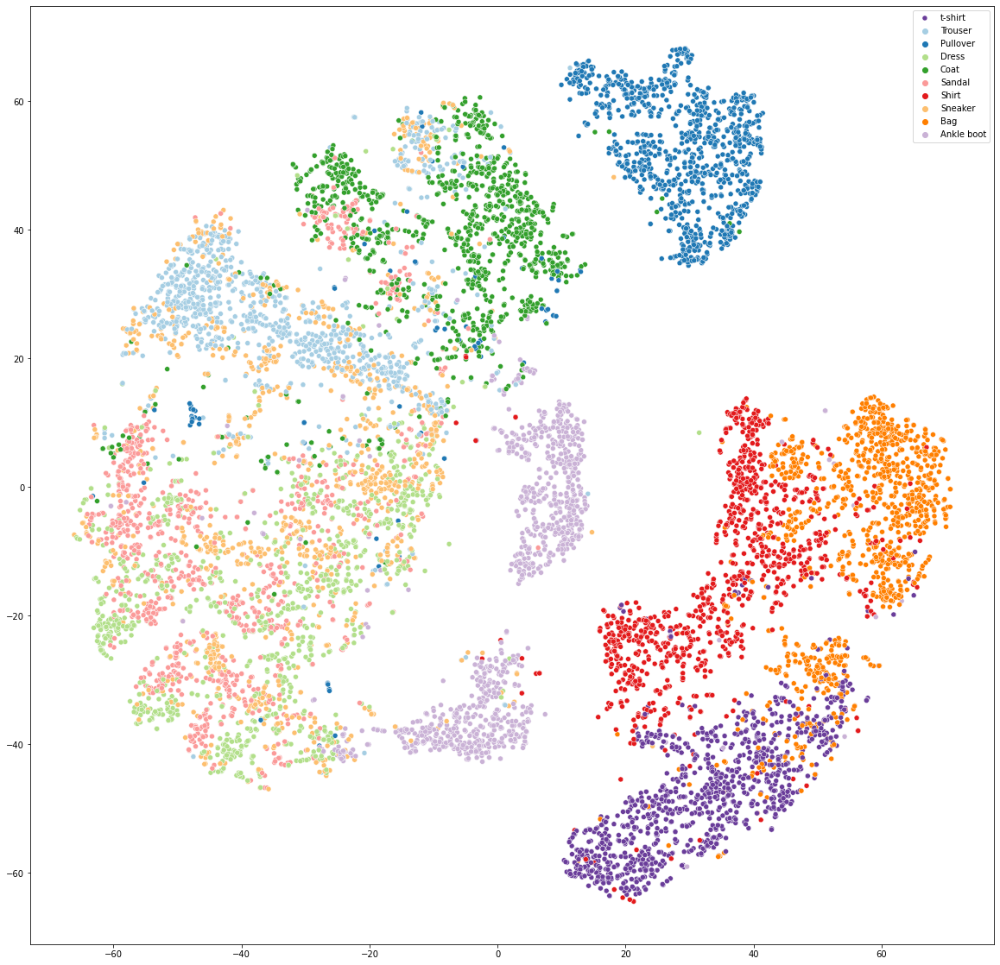

In [12]:
size = 10000
for X, y in trainloader:
    X_pca, X_tsne = pca_tsne_plot(X, y, classes, dataset, size)
torch.save([X_pca, X_tsne], '/Users/peac004/modular_learning_research/modular_deep_learning/results/'+dataset+'_tsne.pt')

In [26]:
tsne_file = '/Users/peac004/modular_learning_research/modular_deep_learning/results/'+dataset+'_tsne.pt'
[X_pca, X_tsne] = torch.load(open(tsne_file,'rb'),
                            map_location=torch.device('cpu')) 

In [12]:
model_file = '/Users/peac004/modular_learning_research/modular_deep_learning/results/'+dataset+'.pt'

In [80]:
models_list = []
for dataset in datasets:
    model_file = '/Users/peac004/modular_learning_research/modular_deep_learning/results/'+dataset+'.pt'
    models_list.append(torch.load(open(model_file,'rb'), 
                    map_location=torch.device('cpu')))

In [40]:
def colors(p,  palette=['y','g','r','c','b','tab:pink']):
    uniq_y = np.unique(p)
    pred_color = [palette[i] for i in uniq_y]
    return pred_color

In [41]:
def get_labels(p, palette=['y','g','r','c','b','tab:pink']):
    pred_labels = torch.argmax(p, dim=1)
    return pred_labels

In [42]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
def predict(dataloader, model):
        
        pred_labels = []
        true_labels = []
        for i, data in enumerate(dataloader):
            inputs, labels = data
            true_labels.append(labels)
            pred_labels.append(torch.argmax(model(inputs), dim=1))
            
        return torch.stack(true_labels), torch.stack(pred_labels)

In [43]:
train_size = 10000
trainloader = torch.utils.data.DataLoader(torch.utils.data.Subset(trainset,list(range(0,train_size))), 
                                          batch_size=train_size,
                                          shuffle=False, num_workers=1)
test_size = 3000
testloader = torch.utils.data.DataLoader(torch.utils.data.Subset(testset,list(range(0,test_size))),
                                         batch_size=test_size,
                                         shuffle=False, num_workers=1)

In [143]:
w_importance = 0.0
histogram = {}
for models in models_list:
    keys = models.keys()
    total_experts = len(models[list(keys)[0]]['experts'])
    num_epochs = len(models[list(keys)[0]]['experts'][1]['history']['loss'])
    w_importance += 0.5 
    print(w_importance)
    for m_key, m_val in models.items():
        if histogram.get(m_key) is None:
            histogram[m_key] = []
        experts = []
        for e in range(1, total_experts+1):
            moe_model = m_val['experts'][e]['model']
            pred_gate = moe_model.gate(X)
            pred_gate_labels = get_labels(pred_gate)+1
            uniq_labels = np.unique(pred_gate_labels)
            experts+=[e]*len(uniq_labels)
        histogram[m_key].append(experts)

0.5
[[1, 2, 2, 3, 4, 4, 4, 4, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 7, 8, 9, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10]] (1, 32)
[[1, 2, 2, 3, 3, 3, 4, 5, 6, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 9, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10]] (1, 35)
[[1, 2, 3, 4, 5, 6, 7, 8, 9, 10]] (1, 10)
1.0
[[1, 2, 2, 3, 4, 4, 4, 4, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 7, 8, 9, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10], [1, 2, 3, 4, 4, 4, 4, 5, 6, 7, 8, 9, 10]] (2,)
[[1, 2, 2, 3, 3, 3, 4, 5, 6, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 9, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10], [1, 2, 3, 4, 5, 6, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 10]] (2,)
[[1, 2, 3, 4, 5, 6, 7, 8, 9, 10], [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]] (2, 10)
1.5
[[1, 2, 2, 3, 4, 4, 4, 4, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 7, 8, 9, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10], [1, 2, 3, 4, 4, 4, 4, 5, 6, 7, 8, 9, 10], [1, 2, 3, 3, 3, 4, 5, 6, 6, 6, 6, 6, 6, 7, 8, 9, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10]] (3,)
[[1, 2,

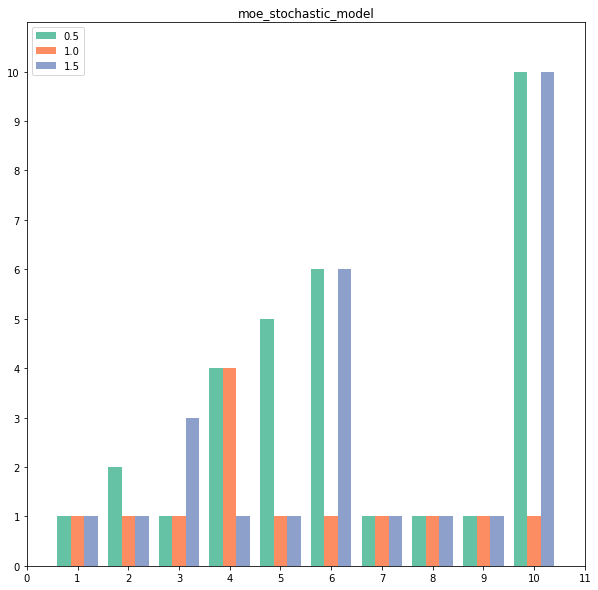

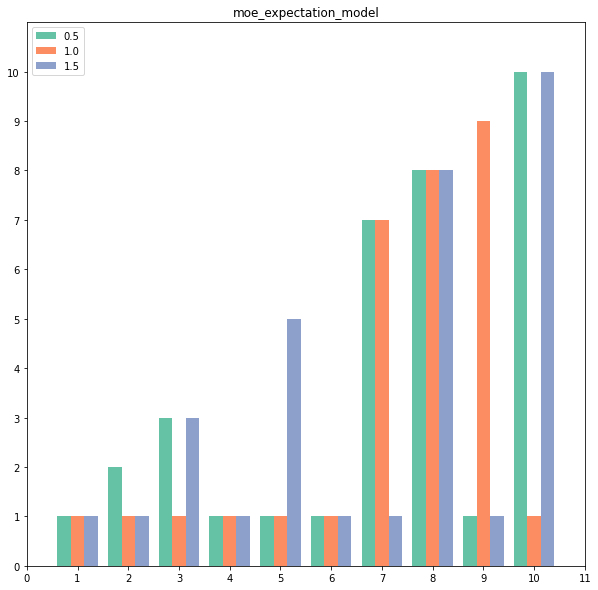

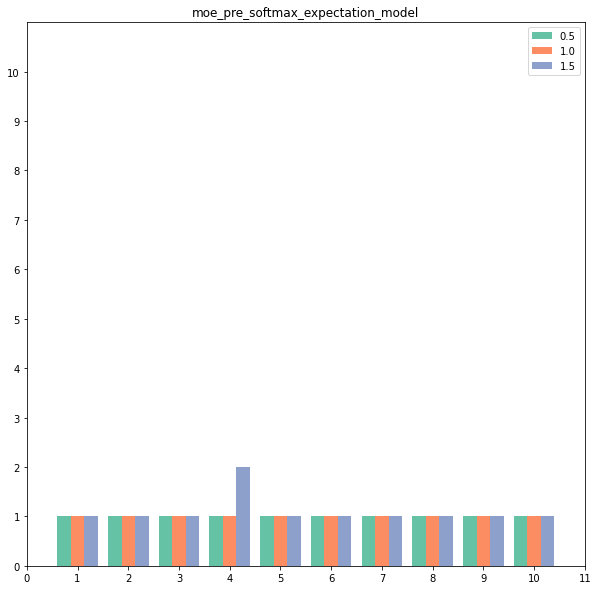

In [159]:
colors=['r','b','g']
palette = sns.color_palette("Set2")
num_classes = len(classes)

for h_key, h_val in histogram.items():
    fig,ax = plt.subplots(1, 1, sharex=True, sharey=True, figsize=(10,10))
    plt.hist(x=h_val, color=palette[0:3],bins=range(1,total_experts+2), label=[0.5,1.0,1.5],align='left')
    plt.legend([0.5,1.0,1.5])
    plt.ylim(0,total_experts+1)
    plt.xticks(range(0,total_experts+2,1))
    plt.yticks(range(0,total_experts+1,1))
    ax.set_title(h_key)
    


Number of Experts: 1


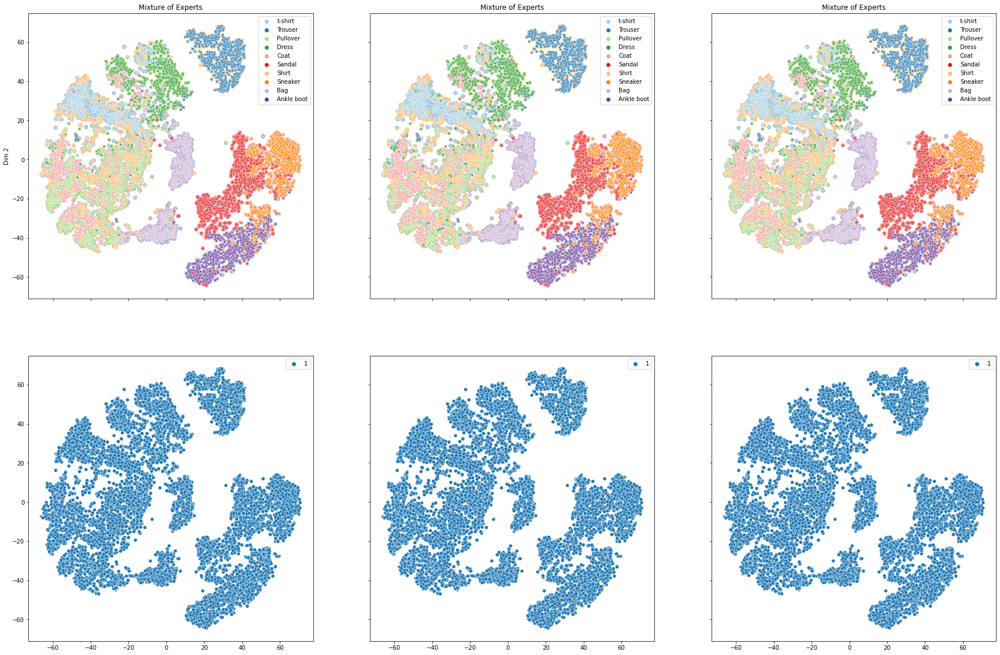

Number of Experts: 2


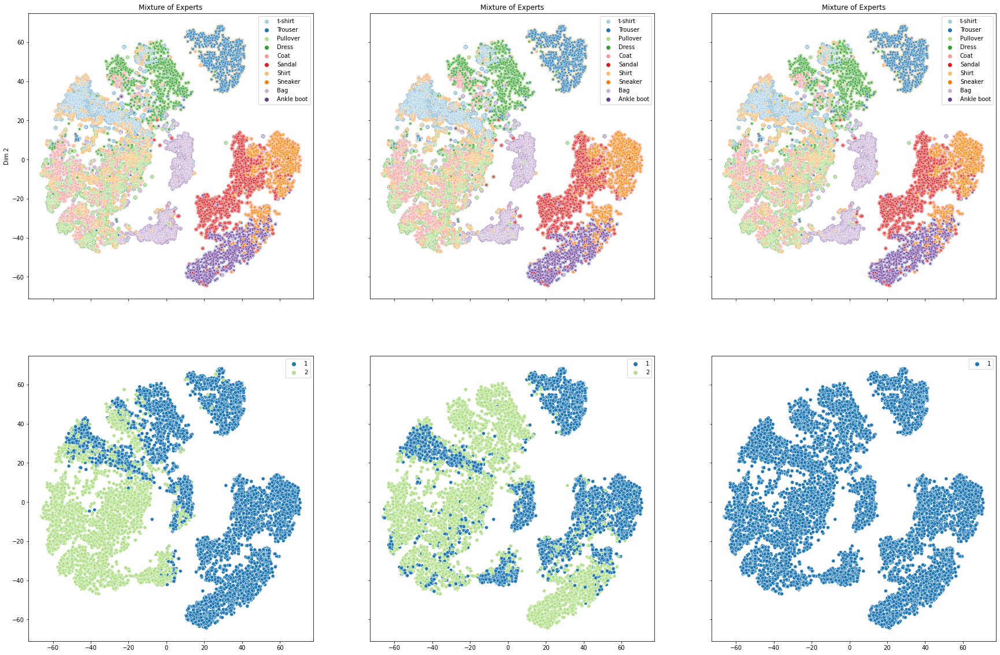

Number of Experts: 3


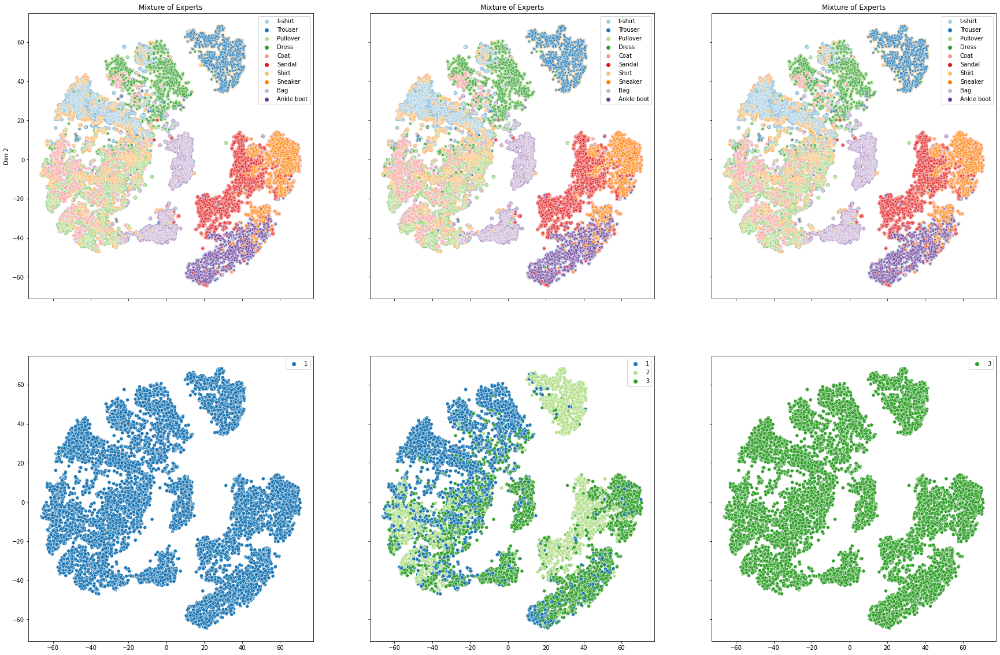

Number of Experts: 4


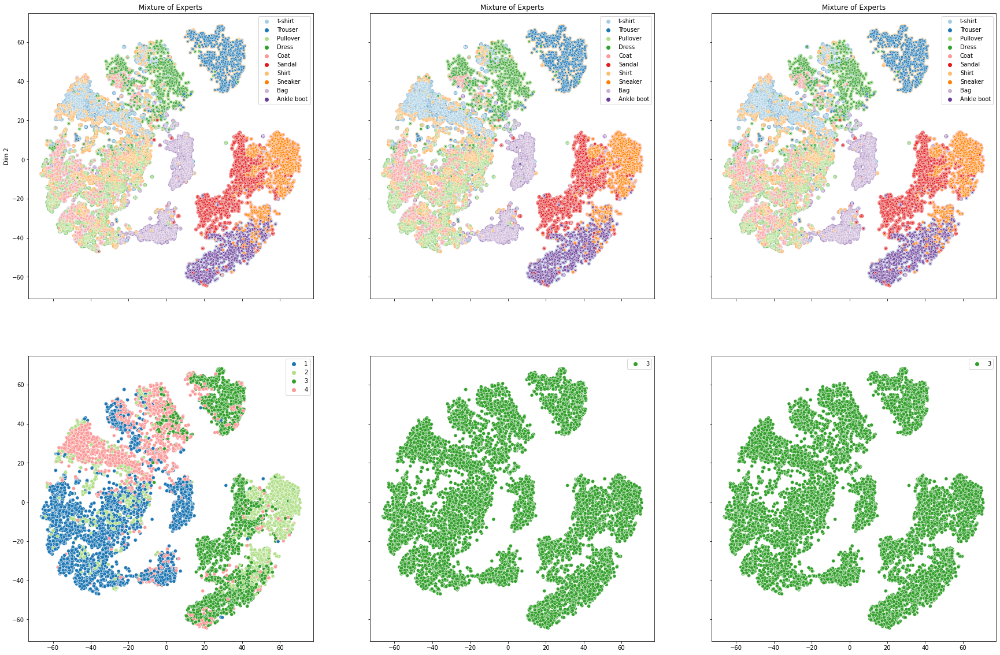

Number of Experts: 5


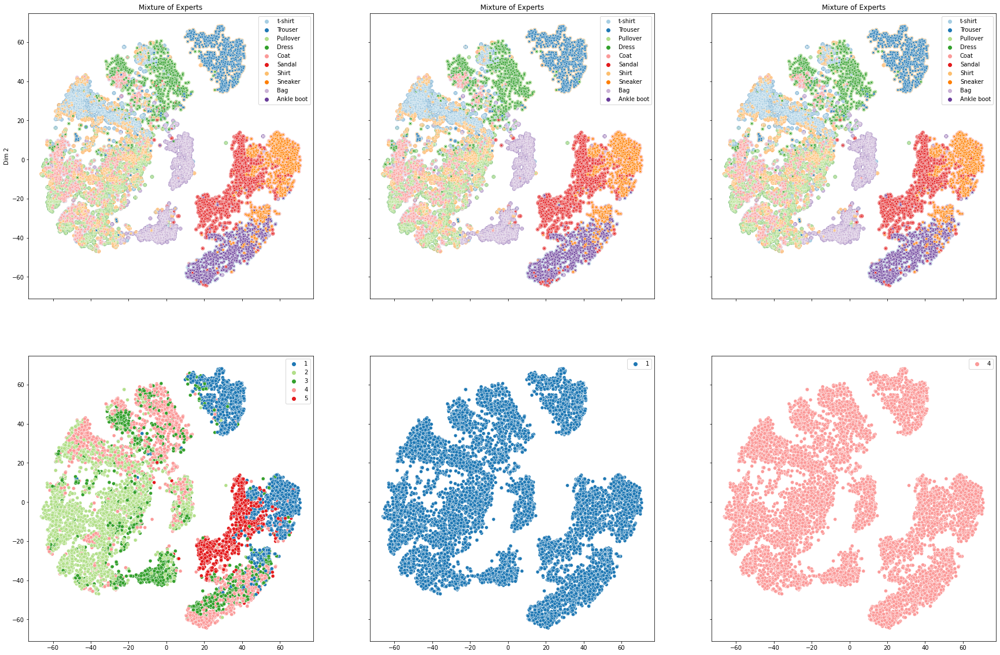

Number of Experts: 6


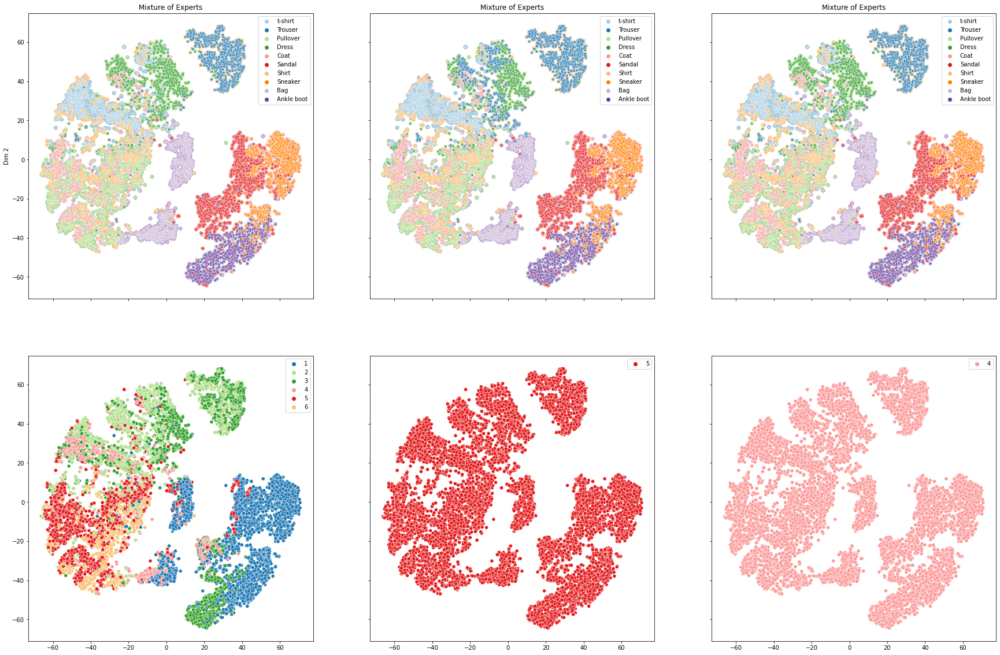

Number of Experts: 7


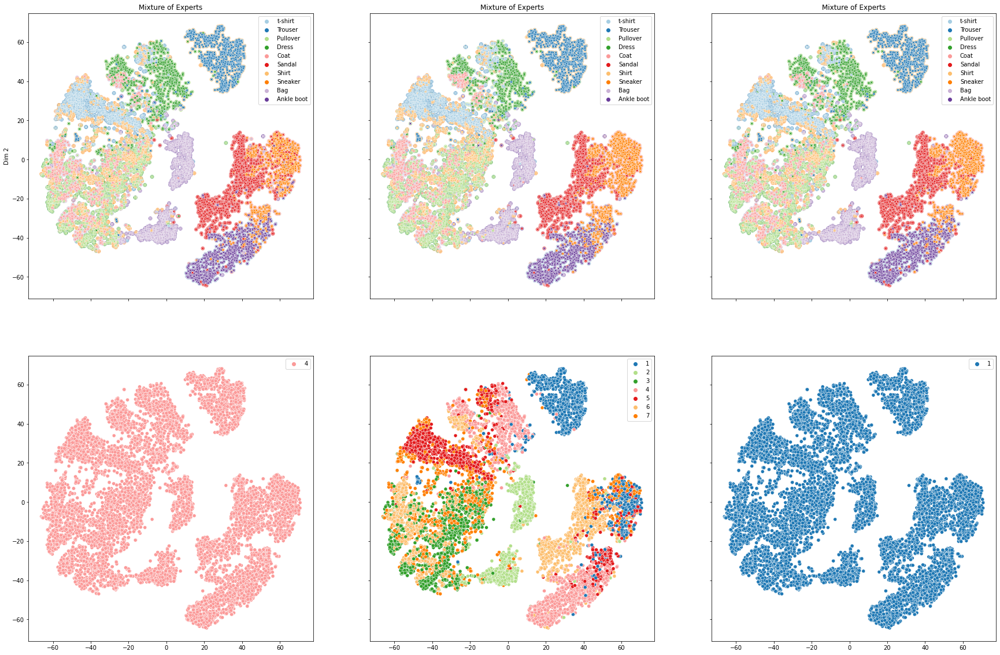

Number of Experts: 8


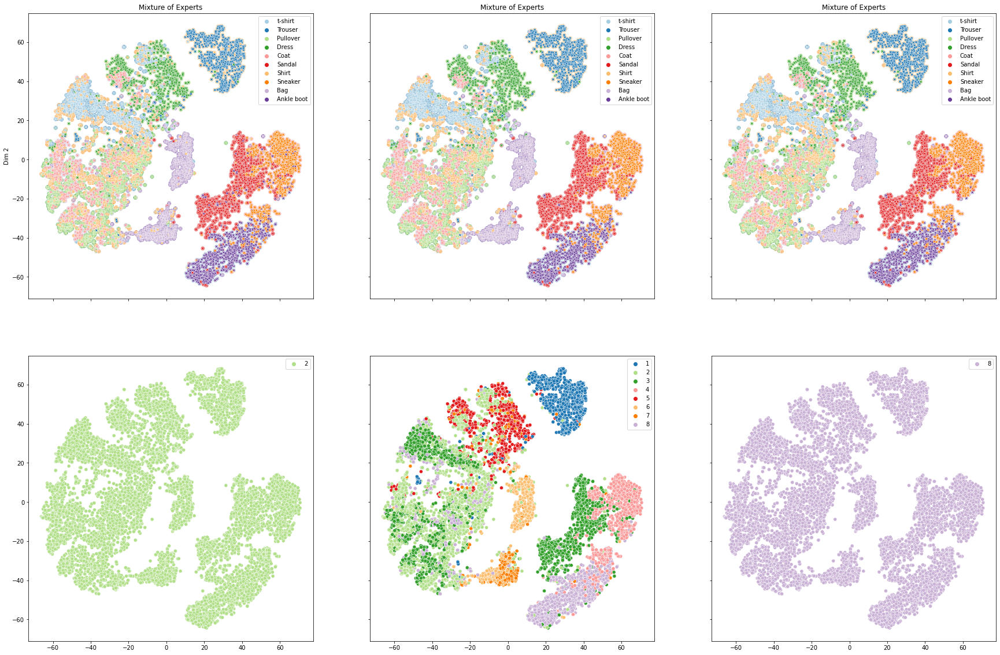

Number of Experts: 9


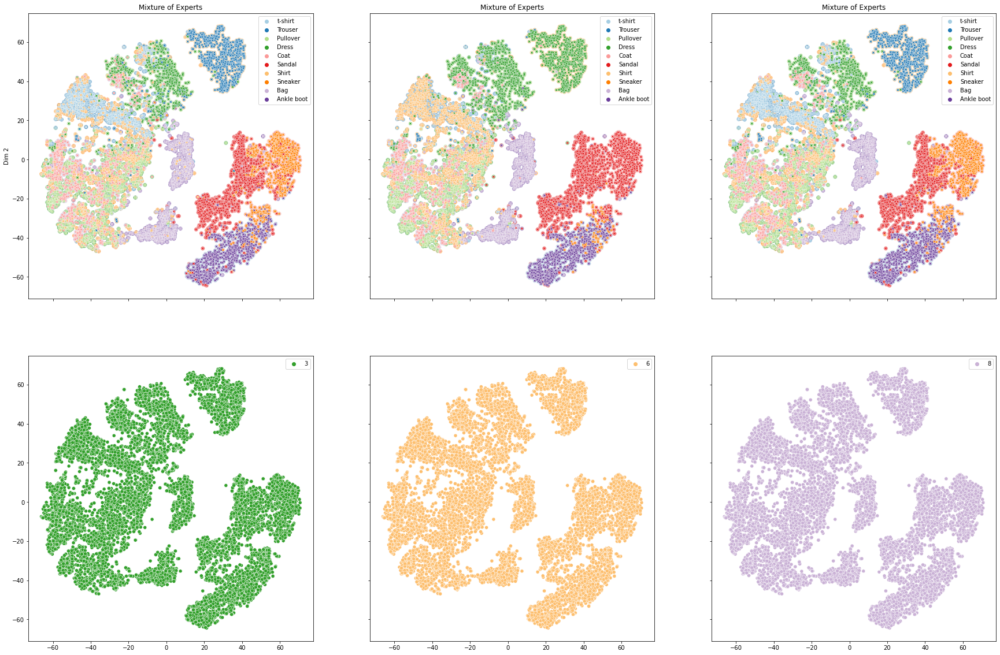

Number of Experts: 10


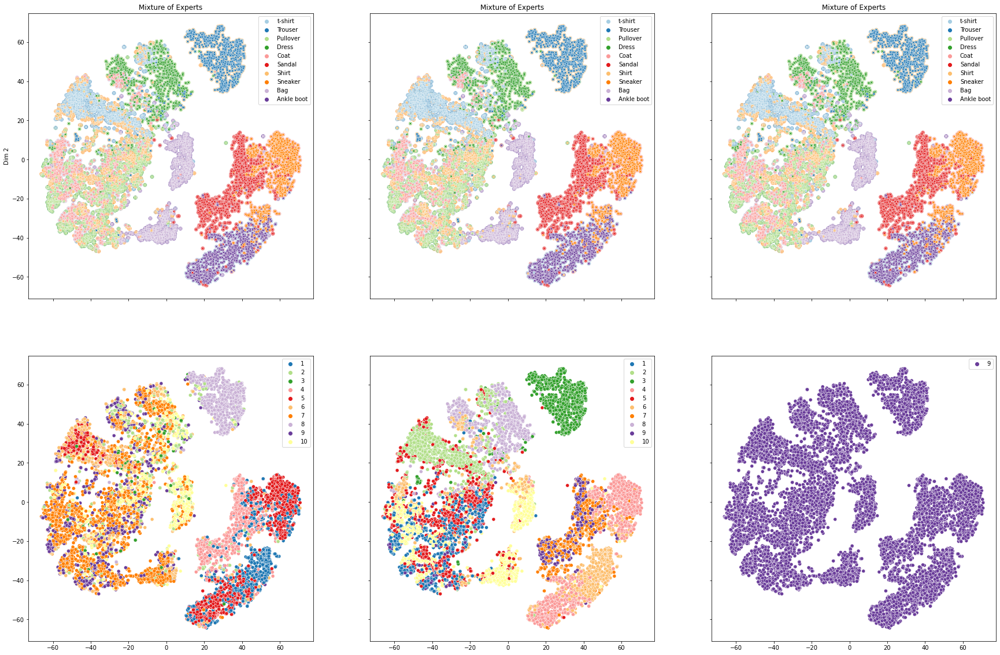

In [28]:
num_classes = len(classes)
keys = models.keys()
total_experts = len(models[list(keys)[0]]['experts'])
num_epochs
for e in range(1, total_experts+1):
    nrows = 2
    ncols = 3
    thefigsize = (ncols*10,nrows*10)

    print('Number of Experts:', e)
    
    fig,ax = plt.subplots(nrows, ncols, sharex=True, sharey=True, figsize=thefigsize)
    ax = ax.flatten()
    
    index = 0
    for X, y in trainloader:
        for m_key, m_val in models.items():

            moe_model = m_val['experts'][e]['model']
 
            palette = sns.color_palette("Paired")+sns.color_palette('Set2')
            pred = moe_model(X)
            pred_labels = get_labels(pred)
            pred_label_names = [classes[i] for i in pred_labels]
            pred_color = colors(pred_labels, palette[0:num_classes])
            pred_classes = [classes[i] for i in np.unique(pred_labels)]
            
            true_label_names = [classes[i] for i in y]
            true_color = colors(y, palette[0:num_classes]) 
            sns.scatterplot(x=X_tsne[:,0],y=X_tsne[:,1], 
                            hue=true_label_names, palette=palette[0:num_classes],ax=ax[index],legend=False, s=50, alpha=0.6)
            sns.scatterplot(x=X_tsne[:,0],y=X_tsne[:,1],
                            hue=pred_label_names,hue_order=pred_classes,palette=pred_color, ax=ax[index],marker='X', s=20,alpha=1.0)
            ax[index].set_title('Mixture of Experts')
            ax[index].set_ylabel('Dim 2')
            ax[index].set_xlabel('Dim 1')
         
            pred_gate = moe_model.gate(X)
            pred_gate_labels = get_labels(pred_gate)+1
            pred_gate_color = colors(pred_gate_labels, palette)

            sns.scatterplot(x=X_tsne[:,0],y=X_tsne[:,1],
                            hue=pred_gate_labels,hue_order=np.unique(pred_gate_labels),palette=pred_gate_color, ax=ax[3+index])       

            index += 1
    plt.savefig('figures/all/'+dataset+'_'+str(num_classes)+'_'+str(e)+'_experts.png')
    plt.show()
    


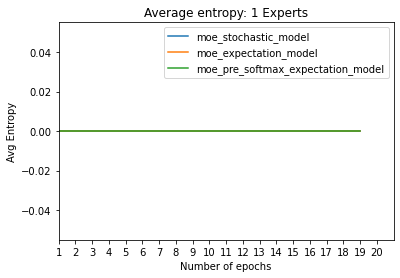

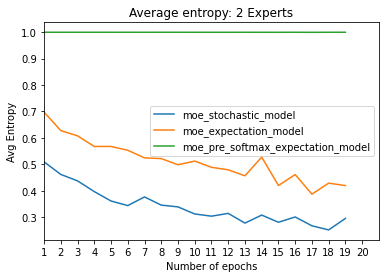

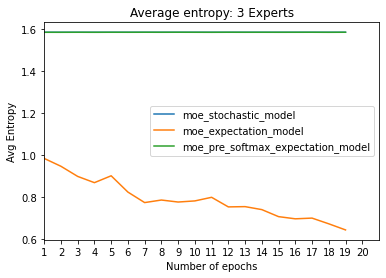

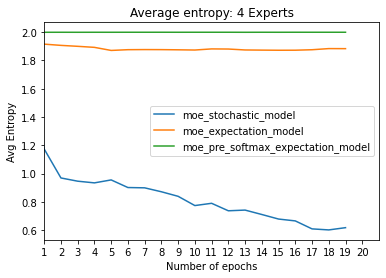

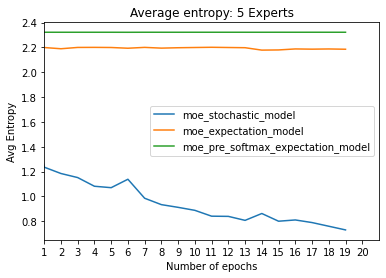

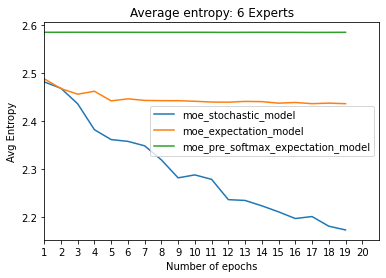

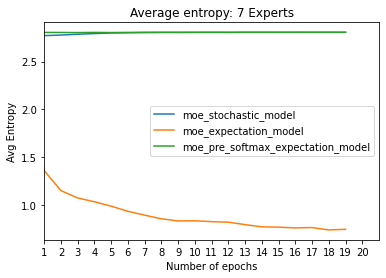

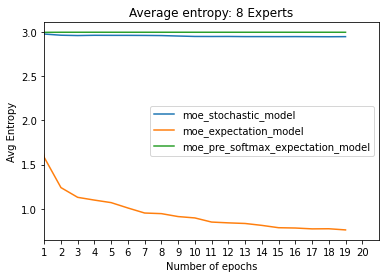

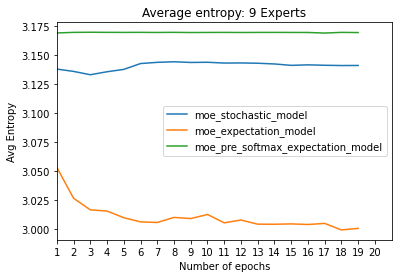

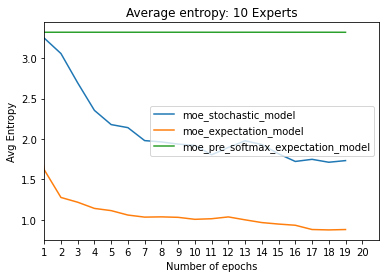

In [32]:
for i in range(1, total_experts+1):
    
    legend_labels = []
    for m_key, m_val in models.items():
        history = m_val['experts'][i]['history']
        plt.plot(range(len(history['entropy'])), history['entropy'])
        legend_labels.append(m_key)
    plt.title('Average entropy: ' + str(i) + ' Experts')
    plt.legend(legend_labels)
    plt.xlabel('Number of epochs')
    plt.xlim(1, num_epochs+1)
    plt.xticks(np.arange(1, num_epochs+1, step=1))
    plt.ylabel('Avg Entropy')
    #plt.ylim(0, 1)
    plt.savefig('figures/all/entropy_'+dataset+'_'+ str(num_classes)+'_'+str(i)+'_experts.png')
    plt.show()

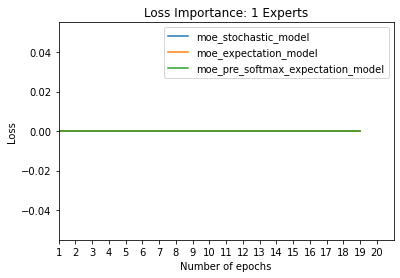

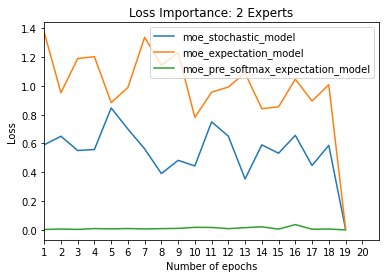

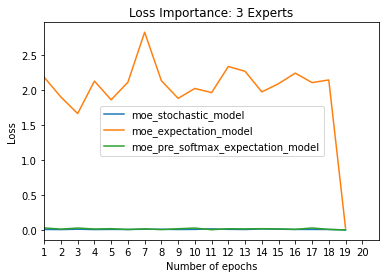

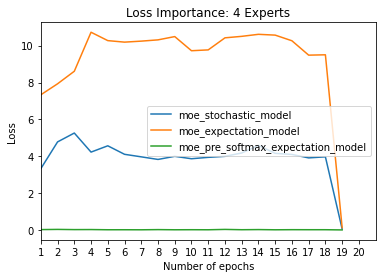

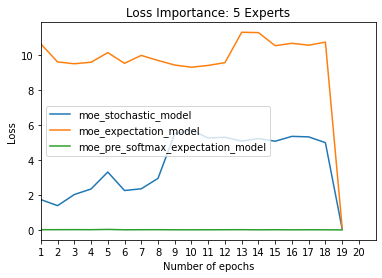

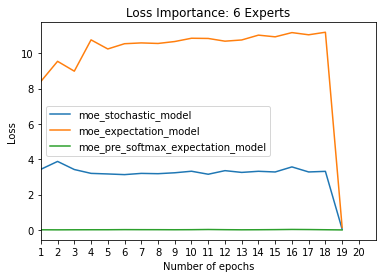

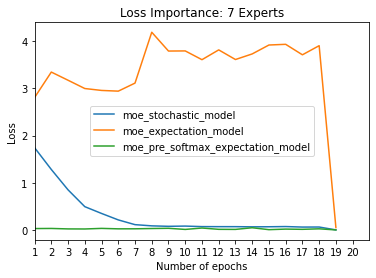

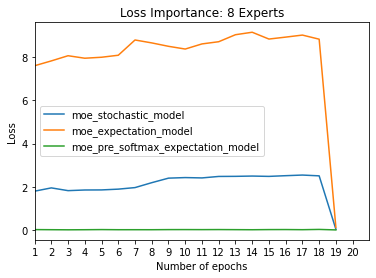

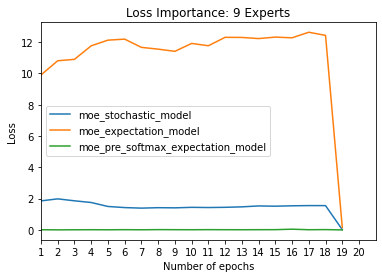

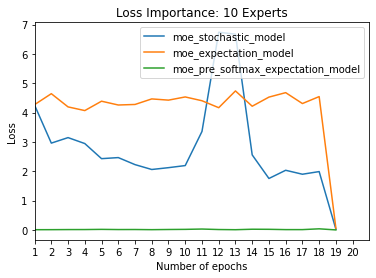

In [33]:
for i in range(1, total_experts+1):
    
    legend_labels = []
    for m_key, m_val in models.items():
        history = m_val['experts'][i]['history']
        plt.plot(range(len(history['loss_importance'])), history['loss_importance'])
        legend_labels.append(m_key)
    plt.title('Loss Importance: ' + str(i) + ' Experts')
    plt.legend(legend_labels)
    plt.xlabel('Number of epochs')
    plt.xlim(1, num_epochs+1)
    plt.xticks(np.arange(1, num_epochs+1, step=1))
    plt.ylabel('Loss')
#     plt.ylim(0, 1)
    plt.savefig('figures/all/loss_importance_'+dataset+'_'+ str(num_classes)+'_'+str(i)+'_experts.png')
    plt.show()

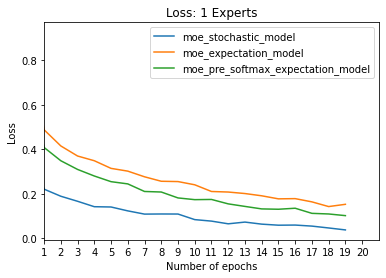

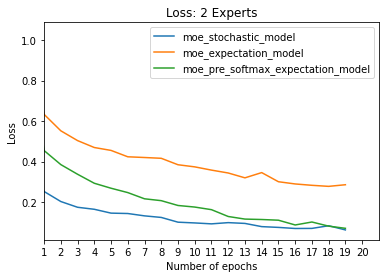

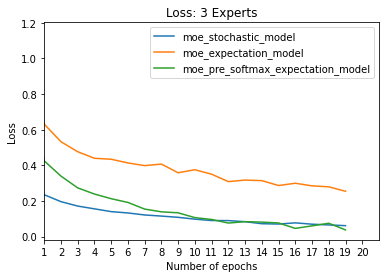

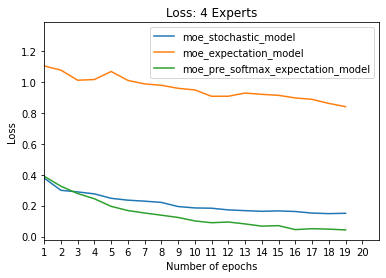

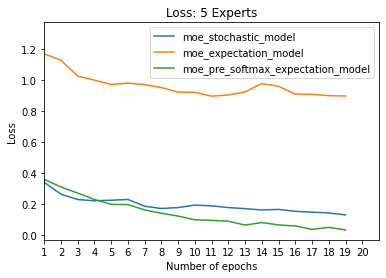

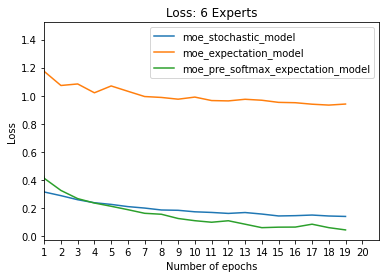

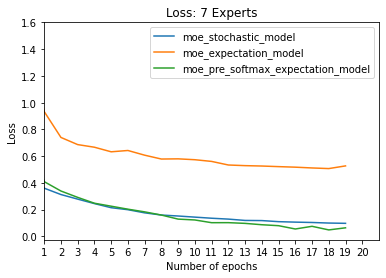

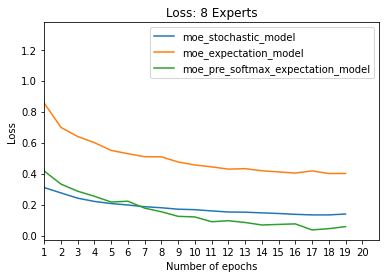

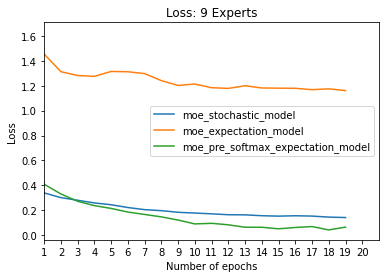

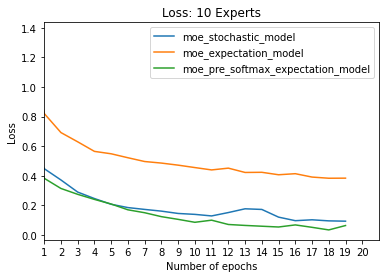

In [34]:
for i in range(1, total_experts+1):
    
    legend_labels = []
    for m_key, m_val in models.items():
        history = m_val['experts'][i]['history']
        plt.plot(range(len(history['loss'])), history['loss'])
        legend_labels.append(m_key)
    plt.title('Loss: ' + str(i) + ' Experts')
    plt.legend(legend_labels)
    plt.xlabel('Number of epochs')
    plt.xlim(1, num_epochs+1)
    plt.xticks(np.arange(1, num_epochs+1, step=1))
    plt.ylabel('Loss')
#     plt.ylim(0, 1)
    plt.savefig('figures/all/loss_'+dataset+'_'+ str(num_classes)+'_'+str(i)+'_experts.png')
    plt.show()

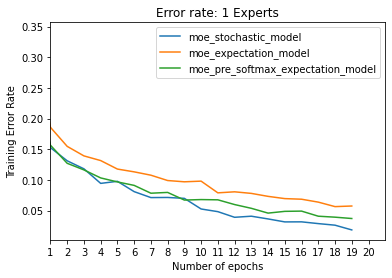

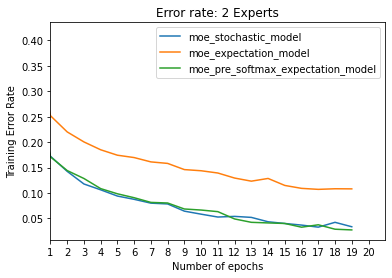

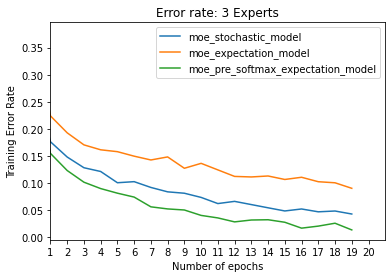

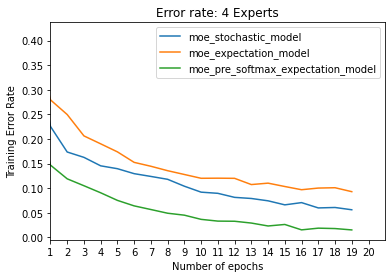

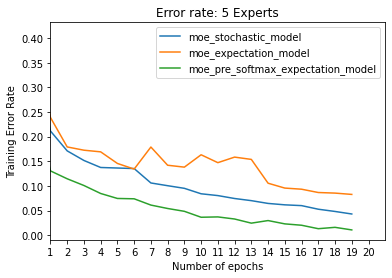

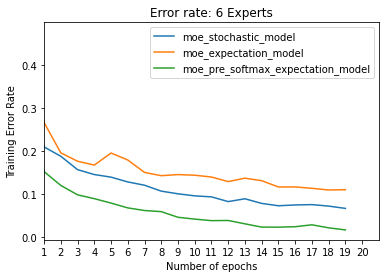

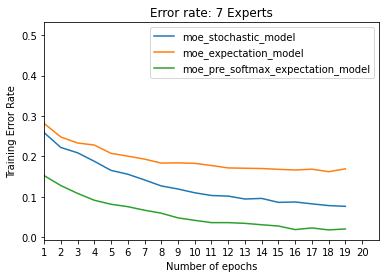

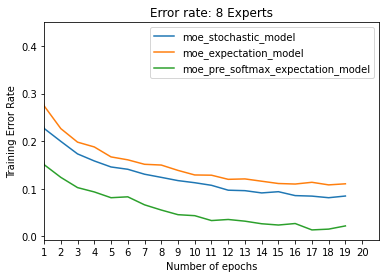

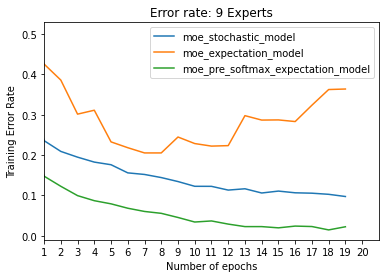

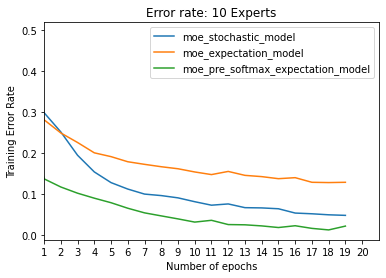

In [35]:
for i in range(1, total_experts+1):
    legend_labels = []
    for m_key, m_val in models.items():
        history = m_val['experts'][i]['history']
        plt.plot(range(len(history['accuracy'])), 1-np.asarray(history['accuracy']))
        legend_labels.append(m_key)
    plt.title('Error rate: ' + str(i) + ' Experts')
    plt.legend(legend_labels)
    plt.xlabel('Number of epochs')
    plt.xlim(1, num_epochs+1)
    plt.xticks(np.arange(1, num_epochs+1, step=1))
    plt.ylabel('Training Error Rate')
#     plt.ylim(0, 1)
    plt.savefig('figures/all/accuracy_'+dataset+'_'+str(num_classes)+'_'+str(i)+'_experts.png')
    plt.show()

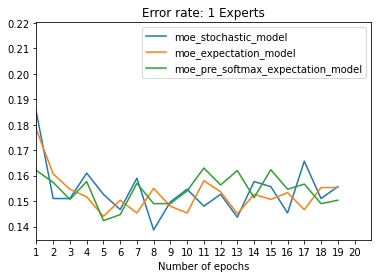

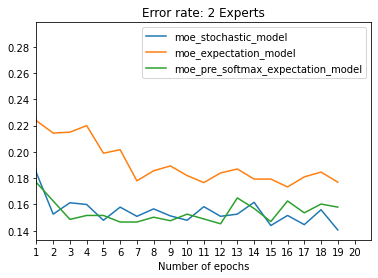

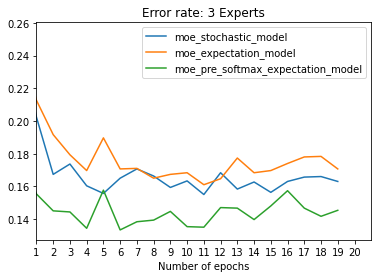

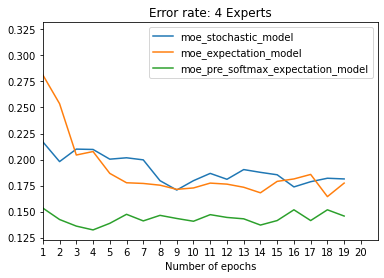

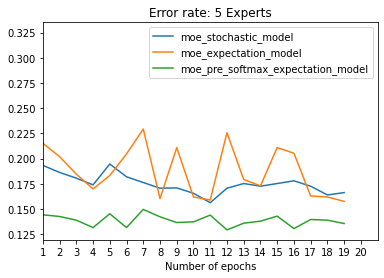

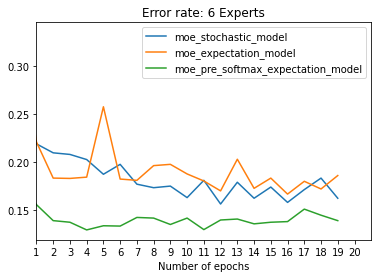

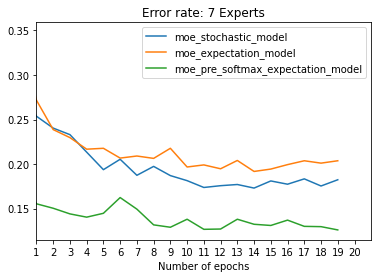

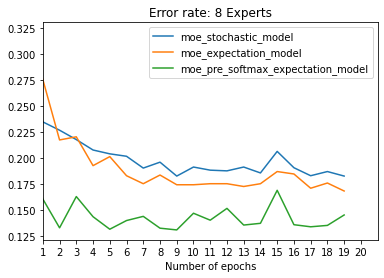

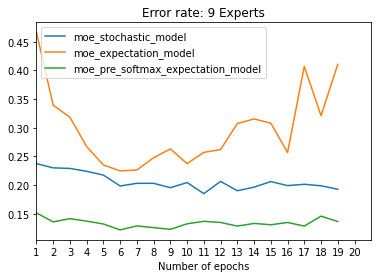

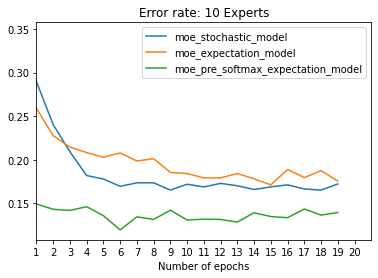

In [36]:
for i in range(1, total_experts+1):
    legend_labels = []
    for m_key, m_val in models.items():
        history = m_val['experts'][i]['history']
        plt.plot(range(len(history['val_accuracy'])), 1-np.asarray(history['val_accuracy']))
        legend_labels.append(m_key)
    plt.title('Error rate: ' + str(i) + ' Experts')
    plt.legend(legend_labels)
    plt.xlabel('Number of epochs')
    plt.xlim(1, num_epochs+1)
    plt.xticks(np.arange(1, num_epochs+1, step=1))
    plt.savefig('figures/all/val_accuracy_'+dataset+'_'+str(num_classes)+'_'+str(i)+'_experts.png')
    plt.show()